# skorch slurm, combined runs for NoCu cv 5 and cv 3

In [8]:
import pandas as pd
import numpy as np
import utils as u
import matplotlib.pyplot as plt
import matplotlib

import altair as alt
import seaborn as sns
import torch_utils as tu



In [4]:
log_data_filename = "data/XY_logTPM_opFilt.tsv"
XY_log = pd.read_csv(log_data_filename,sep='\t')

display(XY_log.head())

,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,medCu,highCu,lowCu,highO2_slow_growth,NO3_lowO2_slow_growth,WithLanthanum,NoLanthanum
0,0,EQU24_RS00005,ACTGTTAGCTTGGCACGGCCCTTGGCTCTGCGGGCGTTAAGGACTT...,5.701712,5.159314,4.946232,4.544309,5.470820,5.489315,5.580793,5.425377,6.017577,5.002269,5.148210,5.063677
1,1,EQU24_RS00010,GTGGACGCGATCACACCACGGTTATTAATGCTTGTAAACGCATTGC...,5.906680,5.431592,5.067489,4.241518,5.897951,6.022614,6.305779,5.935676,6.629400,5.448133,5.385163,5.449226
2,2,EQU24_RS00015,TTGCGAAGAGGGGCGGTTTCTCGTCCGACAGGCGTCGGCGGCAAGG...,5.085045,4.772192,4.208764,4.205855,4.821135,4.878684,5.067555,4.849435,5.487238,4.416274,4.367689,4.534353
3,4,EQU24_RS00025,GATGGGCGACATCGTCGAACCGCGCCGGGATTTCATCGTCAAGAAT...,5.604311,5.064503,4.983838,4.084119,5.639215,5.606737,5.604730,5.671486,6.282482,5.381454,5.098383,5.404872
4,11,EQU24_RS00060,GAATTTTCGGGTTCGGGCATCAGCTACCGGGTATCGCCGGTACTCG...,4.766245,4.767261,3.688497,3.422344,4.763636,4.687598,4.858654,4.698693,4.286940,4.525268,5.031830,5.103249


In [5]:
XY_log.shape

(2204, 15)

In [6]:
condition_file = 'data/conditions_to_include.txt'
with open(condition_file,'r') as f:
    conditions = list(x.strip() for x in f.readlines())
    
cond_dict = dict(enumerate(conditions))
cond_dict

{0: 'uMax',
 1: 'lowO2_fast_growth',
 2: 'lowCH4',
 3: 'MeOH',
 4: 'NoCu',
 5: 'medCu',
 6: 'highCu',
 7: 'lowCu',
 8: 'highO2_slow_growth',
 9: 'NO3_lowO2_slow_growth',
 10: 'WithLanthanum',
 11: 'NoLanthanum'}

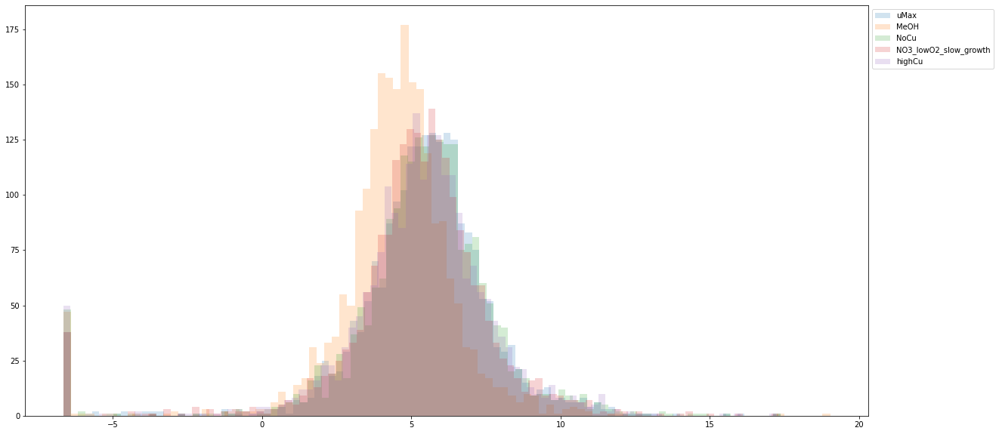

In [9]:
fig = plt.figure(figsize=(20,10))
for c in ['uMax','MeOH','NoCu','NO3_lowO2_slow_growth','highCu']:
    plt.hist(XY_log[c].values,bins=100,alpha=0.2,label=c)

plt.legend(bbox_to_anchor=(1,1),loc='upper left')
plt.show()

In [10]:
df_melt = XY_log.melt(id_vars=['locus_tag'],value_vars=conditions, var_name="condition",value_name='log_tpm')
df_melt

,locus_tag,condition,log_tpm
0,EQU24_RS00005,uMax,5.701712
1,EQU24_RS00010,uMax,5.906680
2,EQU24_RS00015,uMax,5.085045
3,EQU24_RS00025,uMax,5.604311
4,EQU24_RS00060,uMax,4.766245
...,...,...,...
26443,EQU24_RS22110,NoLanthanum,12.312213
26444,EQU24_RS22115,NoLanthanum,4.037671
26445,EQU24_RS22125,NoLanthanum,5.479719
26446,EQU24_RS22130,NoLanthanum,5.433018


In [11]:
#sns.swarmplot(data=df_melt,x='log_tpm',y='condition')

<AxesSubplot:xlabel='log_tpm', ylabel='condition'>

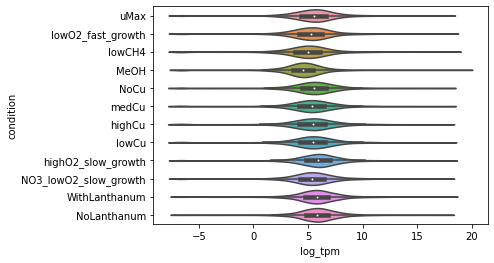

In [12]:
sns.violinplot(data=df_melt,x='log_tpm',y='condition')

## Looking at skorch slurm results

In [20]:
# res_df1 = pd.read_csv('pipe0/res_df.tsv',sep='\t')
# res_df2 = pd.read_csv('pipe1/res_df.tsv',sep='\t')
# res_df = pd.concat([res_df1, res_df2]).reset_index()

# CURRENTLY EDITED FOR AWS INSTANCE FILES
res_df1 = pd.read_csv('../hyak_scp_dump/skorch_randcv_st_noCu_skres_df.tsv',sep='\t')
res_df1['skorch_group'] = 'cv5'
res_df2 = pd.read_csv('../hyak_scp_dump/skorch_randcv_st_noCu_cv3_skres_df.tsv',sep='\t')
res_df2['skorch_group'] = 'cv3'
res_df = pd.concat([res_df1, res_df2]).reset_index()

In [21]:
res_df.sort_values('rank_test_score').head(10)

,index,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_optimizer,param_module__num_filters2,param_module__num_filters1,param_module__kernel_size2,param_module__kernel_size1,...,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,opt_name,skorch_group
133,133,451.082015,108.329205,0.010371,0.001781,<class 'torch.optim.adam.Adam'>,128,32,8,16,...,-4.772701,-4.907837,-5.148625,-5.002009,-7.757717,-5.517778,1.126657,1,Adam,cv5
1813,813,657.857689,27.303953,0.023569,0.003522,<class 'torch.optim.adamw.AdamW'>,128,64,16,8,...,-4.854722,-5.788730,-7.096421,NaN,NaN,-5.913291,0.919398,1,AdamW,cv3
1048,48,642.969185,140.389660,0.053090,0.005622,<class 'torch.optim.rmsprop.RMSprop'>,64,128,12,6,...,-4.547896,-5.822414,-7.425695,NaN,NaN,-5.932002,1.177409,2,RMSprop,cv3
673,673,299.050980,116.363970,0.011649,0.002436,<class 'torch.optim.adam.Adam'>,64,16,16,6,...,-4.693114,-4.766142,-5.634717,-4.960333,-7.739322,-5.558726,1.139853,2,Adam,cv5
1377,377,277.906983,105.632353,0.017412,0.002505,<class 'torch.optim.rmsprop.RMSprop'>,64,128,6,16,...,-4.885797,-5.472824,-7.476592,NaN,NaN,-5.945071,1.109149,3,RMSprop,cv3
695,695,355.717527,155.139316,0.010558,0.001710,<class 'torch.optim.adamw.AdamW'>,64,64,16,8,...,-4.695813,-4.732503,-5.350205,-5.145005,-8.042588,-5.593223,1.249442,3,AdamW,cv5
1548,548,976.560381,162.541767,0.038924,0.006560,<class 'torch.optim.adamw.AdamW'>,64,64,32,6,...,-4.811352,-5.748002,-7.321229,NaN,NaN,-5.960194,1.035580,4,AdamW,cv3
548,548,1562.082563,195.786437,0.027514,0.011019,<class 'torch.optim.adamw.AdamW'>,64,64,32,6,...,-4.597062,-4.994477,-5.251242,-5.325350,-7.958006,-5.625227,1.193869,4,AdamW,cv5
546,546,523.894619,186.242935,0.018666,0.007403,<class 'torch.optim.rmsprop.RMSprop'>,32,128,32,12,...,-4.766513,-4.859671,-5.395956,-5.074685,-8.041739,-5.627713,1.226265,5,RMSprop,cv5
1034,34,324.386551,89.783549,0.021506,0.000386,<class 'torch.optim.rmsprop.RMSprop'>,32,64,32,8,...,-4.723098,-5.674466,-7.516463,NaN,NaN,-5.971342,1.159547,5,RMSprop,cv3


In [22]:
res_df.columns

Index(['index', 'mean_fit_time', 'std_fit_time', 'mean_score_time',
       'std_score_time', 'param_optimizer', 'param_module__num_filters2',
       'param_module__num_filters1', 'param_module__kernel_size2',
       'param_module__kernel_size1', 'param_module__fc_node_num1',
       'param_module__dropout2', 'param_module__dropout1',
       'param_module__conv_pool_size1', 'param_lr', 'params',
       'split0_test_score', 'split1_test_score', 'split2_test_score',
       'split3_test_score', 'split4_test_score', 'mean_test_score',
       'std_test_score', 'rank_test_score', 'opt_name', 'skorch_group'],
      dtype='object')

In [23]:
sm_res_df = res_df[
    ["rank_test_score",
     "mean_test_score",
     "std_test_score",
     "param_module__num_filters2",
     "param_module__num_filters1",
     "param_module__kernel_size2",
     "param_module__kernel_size1",
     "param_lr",
     "param_module__fc_node_num1",
     "param_module__dropout1",
     "param_module__dropout2",
     "param_module__conv_pool_size1",
     "opt_name",
     "skorch_group"
    ]]

In [24]:
alt.Chart(sm_res_df).mark_point(size=100).encode(
    x='rank_test_score:Q',
    y='mean_test_score:Q',
    #color=alt.Color('param_lr:Q',scale=alt.Scale(type='log',scheme='viridis')),
    color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    shape="param_module__num_filters1:N",
    tooltip=["rank_test_score:Q","mean_test_score:Q","param_module__num_filters2:N","param_module__num_filters1:N","param_module__kernel_size2:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N","opt_name:N","skorch_group:N"]
    
).interactive()

alt.Chart(...)

In [27]:
alt.Chart(sm_res_df).mark_point(size=100).encode(
    x=alt.X('param_module__kernel_size1:O',title="kernel size 1"),
    y='mean_test_score:Q',
    color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    column='opt_name:N',
    row='skorch_group:N',
#     detail='model_desc:N',
    shape="param_module__num_filters1:N",
    tooltip=["rank_test_score:O","param_module__num_filters1:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N"]
    
).interactive()

alt.Chart(...)

In [28]:
alt.Chart(sm_res_df).mark_point(size=100).encode(
    x=alt.X('param_module__kernel_size1:O',title="kernel size 1"),
    y='mean_test_score:Q',
    color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    column='param_module__num_filters1:N',
    row='skorch_group:N',
#     detail='model_desc:N',
    shape="opt_name:N",
    tooltip=["rank_test_score:O","param_module__num_filters1:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N"]
    
).interactive()

alt.Chart(...)

In [29]:
alt.Chart(sm_res_df).mark_point(size=100).encode(
    x=alt.X('param_module__num_filters2:O'),#title="kernel size 1"),
    y='mean_test_score:Q',
    color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    column='param_module__num_filters1:N',
    row='skorch_group:N',
#     detail='model_desc:N',
    shape="opt_name:N",
    tooltip=["rank_test_score:O","param_module__num_filters1:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N"]
    
).interactive()

alt.Chart(...)

In [30]:
alt.Chart(sm_res_df).mark_boxplot(extent='min-max').encode(
    x=alt.X('param_module__num_filters2:O'),#title="kernel size 1"),
    y='mean_test_score:Q',
    #color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    column='param_module__num_filters1:N',
    row='skorch_group:N',
#     detail='model_desc:N',
    #shape="opt_name:N",
    #tooltip=["rank_test_score:O","param_module__num_filters1:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N"]
    
).interactive()

alt.Chart(...)

In [32]:
alt.Chart(sm_res_df).mark_boxplot(extent='min-max').encode(
    x=alt.X('param_module__kernel_size1:O'),#title="kernel size 1"),
    y='mean_test_score:Q',
    #color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    column='param_module__kernel_size2:N',
    row='skorch_group:N',
#     detail='model_desc:N',
    #shape="opt_name:N",
    #tooltip=["rank_test_score:O","param_module__num_filters1:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N"]
    
).interactive()

alt.Chart(...)

In [31]:
alt.Chart(sm_res_df).mark_boxplot(extent='min-max').encode(
    x=alt.X('param_module__num_filters1:O'),#title="kernel size 1"),
    y='mean_test_score:Q',
    #color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    column='opt_name:N',
    row='param_lr:N',
#     detail='model_desc:N',
    #shape="opt_name:N",
    #tooltip=["rank_test_score:O","param_module__num_filters1:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N"]
    
).interactive(
).properties(
    height=100,
    width=100
)

alt.Chart(...)

# Take the top percentages

In [41]:
top_df = sm_res_df.sort_values("mean_test_score",ascending=False).head(100)
top_df

,rank_test_score,mean_test_score,std_test_score,param_module__num_filters2,param_module__num_filters1,param_module__kernel_size2,param_module__kernel_size1,param_lr,param_module__fc_node_num1,param_module__dropout1,param_module__dropout2,param_module__conv_pool_size1,opt_name,skorch_group
133,1,-5.517778,1.126657,128,32,8,16,0.00050,100,0.2,0.0,6,Adam,cv5
673,2,-5.558726,1.139853,64,16,16,6,0.00050,100,0.2,0.5,6,Adam,cv5
695,3,-5.593223,1.249442,64,64,16,8,0.00050,25,0.2,0.0,6,AdamW,cv5
548,4,-5.625227,1.193869,64,64,32,6,0.00050,50,0.5,0.0,1,AdamW,cv5
546,5,-5.627713,1.226265,32,128,32,12,0.00050,100,0.2,0.5,3,RMSprop,cv5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1003,16,-6.117256,0.970085,16,128,6,16,0.00010,25,0.5,0.2,6,AdamW,cv3
533,81,-6.120901,1.184894,16,128,12,6,0.00050,10,0.2,0.2,12,SGD,cv5
290,82,-6.123856,1.099601,32,32,32,8,0.00050,10,0.2,0.2,6,RMSprop,cv5
1249,17,-6.132168,0.782504,128,64,6,32,0.00050,50,0.2,0.0,6,RMSprop,cv3


In [42]:
alt.Chart(top_df).mark_boxplot(extent='min-max').encode(
    x=alt.X('param_module__num_filters1:O'),#title="kernel size 1"),
    y='mean_test_score:Q',
    #color=alt.Color('param_lr:N',scale=alt.Scale(scheme='tableau10')),
    column='opt_name:N',
    row='param_lr:N',
#     detail='model_desc:N',
    #shape="opt_name:N",
    #tooltip=["rank_test_score:O","param_module__num_filters1:N","param_module__kernel_size1:N","param_lr:N","param_module__fc_node_num1:N"]
    
).interactive(
).properties(
    height=100,
    width=100
)

alt.Chart(...)

In [58]:
alt.Chart(top_df).mark_point(size=100).encode(
    x=alt.X('param_module__num_filters1:O'),#title="kernel size 1"),
    y='mean_test_score:Q',
    color=alt.Color('rank_test_score:Q',scale=alt.Scale(scheme='viridis')),
    column='opt_name:N',
    row='param_lr:N',
#     detail='model_desc:N',
    shape="param_module__kernel_size1:N",
    tooltip=[
        "rank_test_score:O",
        "param_module__num_filters1:N",
        "param_module__num_filters2:N",
        "param_module__kernel_size1:N",
        "param_module__kernel_size2:N",
        "param_lr:N",
        "param_module__fc_node_num1:N",
        "param_module__dropout1:N",
        "param_module__dropout2:N",
        "param_module__conv_pool_size1:N"
    ]
    
    
).interactive(
).properties(
    height=100,
    width=100
)

alt.Chart(...)

In [20]:
# can I reload the model here and make predictions?

In [50]:
import pickle
import skorch
import torch
import scipy.stats

In [52]:
sk = pickle.load(open("../hyak_scp_dump/skorch_randcv_st_noCu.pkl",'rb'))


In [53]:
sk.best_estimator_

<class 'skorch.regressor.NeuralNetRegressor'>[initialized](
  module_=DNA_2CNN(
    (conv_net): Sequential(
      (0): Conv2d(1, 32, kernel_size=(4, 16), stride=(1, 1))
      (1): ReLU()
      (2): MaxPool2d(kernel_size=(1, 6), stride=(1, 6), padding=0, dilation=1, ceil_mode=False)
      (3): Dropout(p=0.2, inplace=False)
      (4): Conv2d(32, 128, kernel_size=(1, 8), stride=(1, 1))
      (5): ReLU()
      (6): Dropout(p=0.0, inplace=False)
      (7): Flatten()
      (8): Linear(in_features=5120, out_features=100, bias=True)
      (9): ReLU()
      (10): Linear(in_features=100, out_features=1, bias=True)
    )
  ),
)

In [24]:
sk.best_params_

{'optimizer': torch.optim.adam.Adam,
 'module__num_filters2': 128,
 'module__num_filters1': 32,
 'module__kernel_size2': 8,
 'module__kernel_size1': 16,
 'module__fc_node_num1': 100,
 'module__dropout2': 0.0,
 'module__dropout1': 0.2,
 'module__conv_pool_size1': 6,
 'lr': 0.0005}

In [25]:
sk.best_estimator_.max_epochs

3000

In [26]:
# get data
train_df = pd.read_csv('../hyak_scp_dump/skorch_randcv_st_noCu/train_df.tsv',sep='\t').fillna("")
val_df = pd.read_csv('../hyak_scp_dump/skorch_randcv_st_noCu/val_df.tsv',sep='\t').fillna("")
test_df = pd.read_csv('../hyak_scp_dump/skorch_randcv_st_noCu/test_df.tsv',sep='\t').fillna("")
train_full_df = pd.concat([train_df,val_df])

def make_skorch_dfs(df,seq_col='seq',target_col='score'):
    '''
    Make basic X,y matrix,vec for skorch fit() loop.
    '''
    seqs = list(df[seq_col].values)        
    ohe_seqs = torch.stack([torch.tensor(u.one_hot_encode(x)) for x in seqs])

    labels = torch.tensor(list(df[target_col].values)).unsqueeze(1)
    # had to unsqueeze here or else errors later
    
    return ohe_seqs.float(), labels.float()

Xtrain, ytrain = make_skorch_dfs(train_df, seq_col='upstream_region',target_col='NoCu')
Xval, yval = make_skorch_dfs(val_df, seq_col='upstream_region',target_col='NoCu')
Xtest, ytest = make_skorch_dfs(test_df, seq_col='upstream_region',target_col='NoCu')
Xtrain_full, ytrain_full = make_skorch_dfs(train_full_df, seq_col='upstream_region',target_col='NoCu')



In [27]:
train_full_df

,level_0,index,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,medCu,highCu,lowCu,highO2_slow_growth,NO3_lowO2_slow_growth,WithLanthanum,NoLanthanum,gene,product
0,1,1,1,EQU24_RS00010,GTGGACGCGATCACACCACGGTTATTAATGCTTGTAAACGCATTGC...,5.906680,5.431592,5.067489,4.241518,5.897951,6.022614,6.305779,5.935676,6.629400,5.448133,5.385163,5.449226,,DNA polymerase III subunit beta
1,2,2,2,EQU24_RS00015,TTGCGAAGAGGGGCGGTTTCTCGTCCGACAGGCGTCGGCGGCAAGG...,5.085045,4.772192,4.208764,4.205855,4.821135,4.878684,5.067555,4.849435,5.487238,4.416274,4.367689,4.534353,recF,DNA replication/repair protein RecF
2,4,4,11,EQU24_RS00060,GAATTTTCGGGTTCGGGCATCAGCTACCGGGTATCGCCGGTACTCG...,4.766245,4.767261,3.688497,3.422344,4.763636,4.687598,4.858654,4.698693,4.286940,4.525268,5.031830,5.103249,,bifunctional diguanylate cyclase/phosphodieste...
3,6,6,15,EQU24_RS00080,ACTTTTACGGGACCCAGACTGAACGCAACAGGATCGATATTAGGAT...,3.677025,2.914081,2.798380,2.855937,3.402045,3.168685,3.189847,3.146899,3.717265,2.885832,3.709916,3.504557,,hypothetical protein
4,7,7,16,EQU24_RS00085,TTACCGGGCCGGATTTTTTGACATAGTTCGTTTAGGGTTGGCAATT...,6.119559,5.359881,5.232205,4.784122,5.642762,6.053625,6.152638,5.703369,6.023735,5.375778,5.544276,5.753625,,prolipoprotein diacylglyceryl transferase
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
348,2187,2187,4172,EQU24_RS21950,GTTGCCGCCAACAGCAGCGTCAAACGCTCGACATCTTGCTGCGTGT...,4.975076,4.419293,5.124366,4.809172,5.236178,4.964408,5.196246,5.139320,6.622547,4.828331,6.856076,6.244072,,sigma-70 family RNA polymerase sigma factor
349,2195,2195,4190,EQU24_RS22045,CCATGGATGGCGTGTATTAGGGCATCACCAGTAGGCGCTTTAGGCG...,6.461758,6.715490,5.850181,5.851119,6.404126,6.091666,6.058024,6.349203,6.950344,6.978197,8.497115,8.279553,,cyclic nucleotide-binding domain-containing pr...
350,2199,2199,4203,EQU24_RS22110,GAAGACTGCTCGGTTTGCTGTTCTCCTATTTACGTACAAATCGAAG...,13.068657,13.226416,12.868309,10.342361,13.026832,12.534830,12.989492,12.805209,11.760130,12.665751,11.945063,12.312213,,hypothetical protein
351,2200,2200,4204,EQU24_RS22115,AGCGCACCGCTATCGCTCTGGCTTAGATATCAAATCATTCGGCTAA...,5.444645,4.752288,4.198252,3.965749,5.428448,5.457926,5.611595,5.439160,5.341587,4.715536,3.997491,4.037671,,type II toxin-antitoxin system HicA family toxin


In [28]:
best = sk.best_estimator_

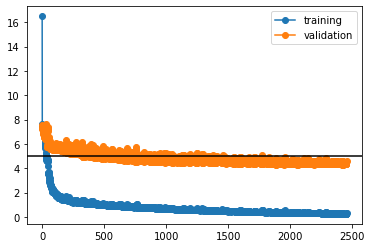

In [29]:
train_loss = best.history[:, 'train_loss']
valid_loss = best.history[:, 'valid_loss']

plt.plot(train_loss, 'o-', label='training')
plt.plot(valid_loss, 'o-', label='validation')
plt.axhline(5,c='k')

plt.legend()
plt.show()

In [45]:
ytrain_pred = best.predict(Xtrain)
yval_pred = best.predict(Xval)
ytest_pred = best.predict(Xtest)

p_train = scipy.stats.pearsonr(np.array(ytrain).flatten(),ytrain_pred.flatten())
p_val = scipy.stats.pearsonr(np.array(yval).flatten(),yval_pred.flatten())
p_test = scipy.stats.pearsonr(np.array(ytest).flatten(),ytest_pred.flatten())


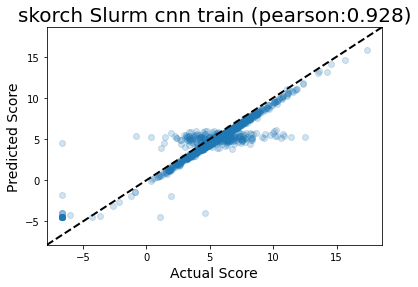

In [81]:
parity_plot(
    "skorch Slurm cnn train", 
    ytrain, 
    ytrain_pred,
    p_train[0],
    rigid=True)


What in the world?!?!

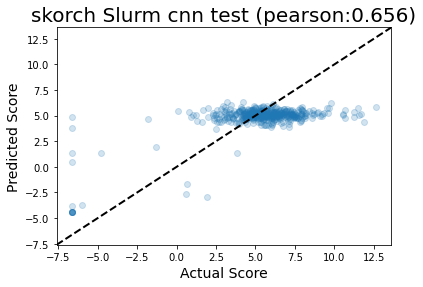

In [82]:
parity_plot(
    "skorch Slurm cnn test", 
    ytest, 
    ytest_pred,
    p_test[0],
    rigid=True)

In [85]:
ytrain.shape

torch.Size([1410, 1])

In [86]:
Xtrain.shape

torch.Size([1410, 300, 4])

In [95]:
train_df['act_vals'] = ytrain.flatten()
train_df['pred_vals'] = ytrain_pred.flatten()

In [99]:
train_df[['locus_tag','gene','product','NoCu','train_vals','act_vals','pred_vals']]

,locus_tag,gene,product,NoCu,train_vals,act_vals,pred_vals
0,EQU24_RS00010,,DNA polymerase III subunit beta,5.897951,5.897951,5.897951,5.287920
1,EQU24_RS00015,recF,DNA replication/repair protein RecF,4.821135,4.821135,4.821135,5.928481
2,EQU24_RS00060,,bifunctional diguanylate cyclase/phosphodieste...,4.763636,4.763636,4.763636,5.239078
3,EQU24_RS00080,,hypothetical protein,3.402045,3.402045,3.402045,4.880067
4,EQU24_RS00085,,prolipoprotein diacylglyceryl transferase,5.642762,5.642762,5.642762,5.241399
...,...,...,...,...,...,...,...
1405,EQU24_RS22030,pcp,pyroglutamyl-peptidase I,5.974878,5.974878,5.974878,5.674215
1406,EQU24_RS22085,,MoxR family ATPase,5.632152,5.632152,5.632152,5.119501
1407,EQU24_RS22090,,POT family MFS transporter,4.372610,4.372611,4.372611,3.854405
1408,EQU24_RS22125,,DUF4102 domain-containing protein,5.473124,5.473124,5.473124,4.995352


In [100]:
alt.Chart(train_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    tooltip=['locus_tag:N','gene:N','product:N']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [102]:
test_df['act_vals'] = ytest.flatten()
test_df['pred_vals'] = ytest_pred.flatten()

In [103]:
alt.Chart(test_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    tooltip=['locus_tag:N','gene:N','product:N']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

# load some gene info?

In [31]:
info_df = pd.read_csv("../5G-rnaseq-sandbox/data/sanity_check_genes.txt",sep='\t').fillna("")

In [32]:
info_df

,group,locus_id,gene,product,notes,Unnamed: 5
0,nif,EQU24_RS17345,nifV,homocitrate synthase,,
1,nif,EQU24_RS17340,cysE(nifP?),serine O-acetyltransferase,,
2,nif,EQU24_RS17335,,hypothetical protein,,
3,nif,EQU24_RS17330,,(2Fe-2S) ferredoxin domain-containing protein,,
4,nif,EQU24_RS17325,,hypothetical protein,,
...,...,...,...,...,...,...
91,cu_repressible,EQU24_RS10665,,chemotaxis protein,Cu Expression analysis doc from Joseph,
92,cu_repressible,EQU24_RS19515,,hypothetical protein,Cu Expression analysis doc from Joseph,
93,cu_repressible,EQU24_RS19510,,DUF2939 domain-containing protein,Cu Expression analysis doc from Joseph,
94,cu_repressible,EQU24_RS05915,,BLUF domain-containing protein,Cu Expression analysis doc from Joseph,


In [33]:
locus2group = dict(info_df[['locus_id','group']].values)
train_full_df['group'] = train_full_df['locus_tag'].apply(lambda x: locus2group[x] if x in locus2group else "other") 
test_df['group'] = test_df['locus_tag'].apply(lambda x: locus2group[x] if x in locus2group else "other") 

In [33]:
alt.Chart(train_full_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color='group:N',
    tooltip=['locus_tag:N','gene:N','product:N','group:N']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [60]:
tpm_df = pd.read_csv('data/extract_TPM_counts.tsv',sep='\t')
locus2coord = dict(tpm_df[['locus_tag','start_coord']].values)

In [61]:
train_full_df['coord'] = train_full_df['locus_tag'].apply(lambda x: locus2coord[x] ) 
test_df['coord'] = test_df['locus_tag'].apply(lambda x: locus2coord[x])

In [157]:
alt.Chart(train_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color=alt.Color('coord:Q',scale=alt.Scale(scheme='viridis')),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [158]:
alt.Chart(test_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color=alt.Color('coord:Q',scale=alt.Scale(scheme='viridis')),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [184]:
thresh = 1000000#1500000#500000
train_df['early'] = train_df['coord'].apply(lambda x: x < thresh)
test_df['early'] = test_df['coord'].apply(lambda x: x < thresh)

alt.Chart(train_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color=alt.Color('early:N'),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [173]:
train_df['sqerr'] = train_df.apply(lambda row: (row['act_vals'] - row['pred_vals'])**2,axis=1)

In [174]:
train_df

,level_0,index,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,...,NoLanthanum,gene,product,train_vals,act_vals,pred_vals,group,coord,early,sqerr
0,1,1,1,EQU24_RS00010,GTGGACGCGATCACACCACGGTTATTAATGCTTGTAAACGCATTGC...,5.906680,5.431592,5.067489,4.241518,5.897951,...,5.449226,,DNA polymerase III subunit beta,5.897951,5.897951,5.287920,other,1502,True,0.372138
1,2,2,2,EQU24_RS00015,TTGCGAAGAGGGGCGGTTTCTCGTCCGACAGGCGTCGGCGGCAAGG...,5.085045,4.772192,4.208764,4.205855,4.821135,...,4.534353,recF,DNA replication/repair protein RecF,4.821135,4.821135,5.928481,other,3060,True,1.226216
2,4,4,11,EQU24_RS00060,GAATTTTCGGGTTCGGGCATCAGCTACCGGGTATCGCCGGTACTCG...,4.766245,4.767261,3.688497,3.422344,4.763636,...,5.103249,,bifunctional diguanylate cyclase/phosphodieste...,4.763636,4.763636,5.239078,other,13842,True,0.226045
3,6,6,15,EQU24_RS00080,ACTTTTACGGGACCCAGACTGAACGCAACAGGATCGATATTAGGAT...,3.677025,2.914081,2.798380,2.855937,3.402045,...,3.504557,,hypothetical protein,3.402045,3.402045,4.880067,other,20389,True,2.184549
4,7,7,16,EQU24_RS00085,TTACCGGGCCGGATTTTTTGACATAGTTCGTTTAGGGTTGGCAATT...,6.119559,5.359881,5.232205,4.784122,5.642762,...,5.753625,,prolipoprotein diacylglyceryl transferase,5.642762,5.642762,5.241399,other,21633,True,0.161093
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1405,2193,2193,4187,EQU24_RS22030,CGAACAGGCTTGGGCATGGGTCGATTCGATACAAGATGCTTGGGCG...,6.663969,6.174425,5.409798,5.321395,5.974878,...,5.772267,pcp,pyroglutamyl-peptidase I,5.974878,5.974878,5.674215,other,4975284,False,0.090398
1406,2197,2197,4198,EQU24_RS22085,AATCGACCCGGTCAATTTATACACAGTAATACACAAGAAACTCACC...,6.227108,5.627004,5.073001,4.744599,5.632152,...,6.089869,,MoxR family ATPase,5.632152,5.632152,5.119501,other,4987320,False,0.262811
1407,2198,2198,4199,EQU24_RS22090,ACAACTTTTATGCCGAAAGGTTCCCATTGTATCTGTATGAGGACCG...,4.525321,4.229571,3.885579,4.106419,4.372610,...,4.251908,,POT family MFS transporter,4.372611,4.372611,3.854405,other,4988781,False,0.268537
1408,2201,2201,4206,EQU24_RS22125,ACTGGTACGACAGCGAAACAATTTTAAAGAAATAGCACGACACGTT...,5.525397,4.994987,4.338536,4.700682,5.473124,...,5.479719,,DUF4102 domain-containing protein,5.473124,5.473124,4.995352,other,4994218,False,0.228266


In [177]:
alt.Chart(train_df).mark_point(size=100).encode(
    x='coord:Q',
    y='sqerr:Q',
    #color=alt.Color('sqerr:Q'),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [182]:
alt.Chart(train_df).mark_point(size=100).encode(
    x='coord:Q',
    y='pred_vals:Q',
    color=alt.Color('sqerr:Q',scale=alt.Scale(scheme='viridis',type='log')),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

# Retrain best model type and see if prediction cloud is still there?

In [34]:
import utils as u 
import torch_utils as tu
import models as m 

In [35]:
sk.best_estimator_.history

[{'batches': [{'train_loss': 41.00633239746094, 'train_batch_size': 128},
   {'train_loss': 30.959775924682617, 'train_batch_size': 128},
   {'train_loss': 22.449846267700195, 'train_batch_size': 128},
   {'train_loss': 17.417837142944336, 'train_batch_size': 128},
   {'train_loss': 9.34539794921875, 'train_batch_size': 128},
   {'train_loss': 6.318612098693848, 'train_batch_size': 128},
   {'train_loss': 10.651711463928223, 'train_batch_size': 128},
   {'train_loss': 12.214578628540039, 'train_batch_size': 128},
   {'train_loss': 14.598072052001953, 'train_batch_size': 128},
   {'train_loss': 7.690574645996094, 'train_batch_size': 128},
   {'train_loss': 8.751293182373047, 'train_batch_size': 128},
   {'train_loss': 23.433504104614258, 'train_batch_size': 2},
   {'valid_loss': 7.644078254699707, 'valid_batch_size': 128},
   {'valid_loss': 4.9402079582214355, 'valid_batch_size': 128},
   {'valid_loss': 10.860478401184082, 'valid_batch_size': 97}],
  'epoch': 1,
  'train_batch_count': 1

In [36]:
sk.best_params_

{'optimizer': torch.optim.adam.Adam,
 'module__num_filters2': 128,
 'module__num_filters1': 32,
 'module__kernel_size2': 8,
 'module__kernel_size1': 16,
 'module__fc_node_num1': 100,
 'module__dropout2': 0.0,
 'module__dropout1': 0.2,
 'module__conv_pool_size1': 6,
 'lr': 0.0005}

In [37]:
sk.best_estimator_.callbacks[1].patience

500

In [194]:
best_redo = m.DNA_2CNN(
    300,
    module__num_filters1=32,
    module__num_filters2=128,
    module__kernel_size1=16,
    module__kernel_size2=8,
    module__conv_pool_size1=6, # default no pooling
    module__conv_pool_size2=1,
    module__fc_node_num1 = 100,
    module__fc_node_num2 = 10,
    module__dropout1 = 0.2,
    module__dropout2 = 0.0,
)

In [47]:
from skorch import NeuralNetRegressor
from skorch.callbacks import EarlyStopping,Checkpoint
from skorch.dataset import Dataset
from skorch.helper import predefined_split


In [39]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
DEVICE

device(type='cpu')

In [42]:
valid_ds = Dataset(Xval, yval)

In [86]:
# Make a skorch regressor object
net_regr = NeuralNetRegressor(
    m.DNA_2CNN, # my pytorch model
    module__seq_len=300, # pass arg to pytorch model
    module__num_filters1=32,
    module__num_filters2=128,
    module__kernel_size1=16,
    module__kernel_size2=8,
    module__conv_pool_size1=6, 
    module__conv_pool_size2=1,
    module__fc_node_num1 = 100,
    module__fc_node_num2 = 10,
    module__dropout1 = 0.2,
    module__dropout2 = 0.0,
    max_epochs=3000,
    lr=0.0005,
    device=DEVICE,  # uncomment this to train with CUDA
#     callbacks=[
#         EarlyStopping(patience=500),
#         Checkpoint(dirname='redo_best_st',f_pickle='best_chkpt.pkl')],
    optimizer=torch.optim.Adam,
    iterator_train__shuffle=True,
    train_split=None#predefined_split(valid_ds)
)

In [87]:
# Xtrain_full = torch.cat((Xtrain,Xval),0)
# ytrain_full = torch.cat((ytrain,yval),0)

In [88]:
ytrain_full.shape

torch.Size([1763, 1])

In [89]:
# Just call fit!
net_regr.fit(Xtrain_full, ytrain_full)
#net_regr.fit(Xtrain, ytrain)

final linear_node_num: 5120
  epoch    train_loss     dur
-------  ------------  ------
      1       14.1407  0.2108
      2        7.9438  0.1839
      3        7.4398  0.1778
      4        7.4033  0.1888
      5        7.2728  0.1756
      6        7.2179  0.1759
      7        7.2466  0.1552
      8        7.2294  0.1427
      9        7.1024  0.1578
     10        7.0767  0.1769
     11        6.9687  0.1410
     12        6.8918  0.1550
     13        6.8067  0.1532
     14        6.8184  0.1224
     15        6.6254  0.1215
     16        6.5098  0.1213
     17        6.6585  0.1204
     18        6.7374  0.1205
     19        6.3276  0.1196
     20        6.2708  0.1203
     21        6.0362  0.1197
     22        5.8688  0.1192
     23        6.1128  0.1198
     24        5.9165  0.1197
     25        5.5872  0.1207
     26        5.5257  0.1184
     27        5.1522  0.1190
     28        5.1848  0.1189
     29        4.9278  0.1204
     30        4.8293  0.1201
     31     

    243        0.5135  0.1228
    244        0.5297  0.1230
    245        0.4976  0.1231
    246        0.4938  0.1232
    247        0.5366  0.1230
    248        0.5095  0.1233
    249        0.5248  0.1232
    250        0.5288  0.1231
    251        0.5108  0.1233
    252        0.5015  0.1228
    253        0.4725  0.1226
    254        0.4622  0.1229
    255        0.4850  0.1233
    256        0.4929  0.1234
    257        0.4663  0.1237
    258        0.4835  0.1231
    259        0.4758  0.1241
    260        0.4702  0.1235
    261        0.4803  0.1232
    262        0.4547  0.1236
    263        0.4737  0.1229
    264        0.5052  0.1236
    265        0.4986  0.1237
    266        0.4499  0.1231
    267        0.4934  0.1231
    268        0.4783  0.1232
    269        0.4830  0.1236
    270        0.4725  0.1266
    271        0.4758  0.1231
    272        0.4997  0.1231
    273        0.5327  0.1244
    274        0.4643  0.1240
    275        0.4768  0.1242
    276   

    510        0.3234  0.1384
    511        0.3024  0.1230
    512        0.3066  0.1227
    513        0.2964  0.1224
    514        0.3255  0.1229
    515        0.2932  0.1229
    516        0.2967  0.1229
    517        0.3038  0.1223
    518        0.2949  0.1229
    519        0.3075  0.1226
    520        0.3191  0.1231
    521        0.3045  0.1222
    522        0.3012  0.1227
    523        0.3171  0.1228
    524        0.2999  0.1227
    525        0.3140  0.1221
    526        0.3299  0.1230
    527        0.3144  0.1228
    528        0.3047  0.1226
    529        0.3036  0.1228
    530        0.3431  0.1226
    531        0.3097  0.1229
    532        0.3389  0.1225
    533        0.3139  0.1227
    534        0.2881  0.1234
    535        0.3339  0.1227
    536        0.3062  0.1229
    537        0.3017  0.1221
    538        0.2820  0.1230
    539        0.2986  0.1225
    540        0.3080  0.1223
    541        0.2899  0.1225
    542        0.2861  0.1227
    543   

    780        0.2504  0.1223
    781        0.2463  0.1225
    782        0.2539  0.1225
    783        0.2545  0.1217
    784        0.2613  0.1223
    785        0.2625  0.1219
    786        0.2572  0.1229
    787        0.2518  0.1221
    788        0.2571  0.1222
    789        0.2399  0.1222
    790        0.2446  0.1219
    791        0.2674  0.1219
    792        0.2340  0.1220
    793        0.2644  0.1219
    794        0.2388  0.1217
    795        0.2544  0.1221
    796        0.2554  0.1221
    797        0.2431  0.1219
    798        0.2768  0.1223
    799        0.2394  0.1222
    800        0.2592  0.1223
    801        0.2516  0.1221
    802        0.2477  0.1225
    803        0.2589  0.1224
    804        0.2583  0.1223
    805        0.2658  0.1222
    806        0.2357  0.1226
    807        0.2500  0.1223
    808        0.2446  0.1224
    809        0.2360  0.1221
    810        0.2380  0.1221
    811        0.2472  0.1228
    812        0.2541  0.1225
    813   

   1051        0.2269  0.1257
   1052        0.2310  0.1216
   1053        0.2350  0.1214
   1054        0.2131  0.1321
   1055        0.2230  0.1246
   1056        0.2161  0.1216
   1057        0.2133  0.1220
   1058        0.2154  0.1212
   1059        0.2327  0.1215
   1060        0.2111  0.1251
   1061        0.2141  0.1216
   1062        0.2055  0.1214
   1063        0.2282  0.1216
   1064        0.2108  0.1214
   1065        0.2321  0.1210
   1066        0.2243  0.1347
   1067        0.2247  0.1220
   1068        0.2352  0.1214
   1069        0.2342  0.1213
   1070        0.2241  0.1218
   1071        0.2169  0.1215
   1072        0.2165  0.1214
   1073        0.2221  0.1219
   1074        0.2410  0.1216
   1075        0.2086  0.1210
   1076        0.2191  0.1216
   1077        0.2156  0.1222
   1078        0.2149  0.1227
   1079        0.2067  0.1425
   1080        0.2130  0.1313
   1081        0.2152  0.1212
   1082        0.2199  0.1211
   1083        0.2145  0.1213
   1084   

   1322        0.2111  0.1630
   1323        0.2229  0.1210
   1324        0.2031  0.1219
   1325        0.2076  0.1218
   1326        0.1932  0.1209
   1327        0.2169  0.1905
   1328        0.1973  0.1605
   1329        0.1937  0.1430
   1330        0.1961  0.1318
   1331        0.2039  0.1222
   1332        0.1997  0.1217
   1333        0.1937  0.1204
   1334        0.1863  0.1239
   1335        0.1980  0.1207
   1336        0.2025  0.1484
   1337        0.2279  0.1775
   1338        0.2012  0.1458
   1339        0.2008  0.1453
   1340        0.1961  0.1872
   1341        0.1927  0.1511
   1342        0.2034  0.1405
   1343        0.2022  0.1417
   1344        0.2093  0.1786
   1345        0.1958  0.1557
   1346        0.1992  0.1221
   1347        0.2025  0.1259
   1348        0.1912  0.1218
   1349        0.2027  0.1216
   1350        0.2092  0.1214
   1351        0.1929  0.1215
   1352        0.2009  0.1209
   1353        0.2004  0.1219
   1354        0.1943  0.1210
   1355   

   1594        0.2023  0.1212
   1595        0.1873  0.1214
   1596        0.1688  0.1216
   1597        0.1927  0.1210
   1598        0.1985  0.1213
   1599        0.1923  0.1214
   1600        0.1742  0.1215
   1601        0.1942  0.1219
   1602        0.1854  0.1216
   1603        0.1989  0.1215
   1604        0.1934  0.1212
   1605        0.1824  0.1212
   1606        0.1885  0.1214
   1607        0.1898  0.1215
   1608        0.1875  0.1215
   1609        0.1800  0.1215
   1610        0.1954  0.1222
   1611        0.1930  0.1218
   1612        0.1899  0.1213
   1613        0.1948  0.1219
   1614        0.1906  0.1216
   1615        0.1799  0.1217
   1616        0.1860  0.1214
   1617        0.1885  0.1217
   1618        0.1897  0.1220
   1619        0.1949  0.1214
   1620        0.1952  0.1214
   1621        0.1839  0.1215
   1622        0.1890  0.1214
   1623        0.1859  0.1211
   1624        0.1947  0.1212
   1625        0.1982  0.1213
   1626        0.2014  0.1219
   1627   

   1867        0.1853  0.1212
   1868        0.1831  0.1250
   1869        0.1701  0.1210
   1870        0.1633  0.1213
   1871        0.1727  0.1212
   1872        0.1627  0.1214
   1873        0.1840  0.1212
   1874        0.1811  0.1218
   1875        0.1752  0.1211
   1876        0.1845  0.1224
   1877        0.1797  0.1213
   1878        0.1743  0.1220
   1879        0.1657  0.1213
   1880        0.1730  0.1228
   1881        0.1786  0.1710
   1882        0.1828  0.1578
   1883        0.1667  0.1253
   1884        0.1968  0.1223
   1885        0.1764  0.1227
   1886        0.1750  0.1221
   1887        0.1827  0.1221
   1888        0.1773  0.1224
   1889        0.1826  0.1222
   1890        0.1813  0.1222
   1891        0.1831  0.1219
   1892        0.1805  0.1225
   1893        0.1748  0.1220
   1894        0.1768  0.1221
   1895        0.1768  0.1219
   1896        0.1904  0.1222
   1897        0.1810  0.1220
   1898        0.1787  0.1222
   1899        0.1878  0.1221
   1900   

   2140        0.1692  0.1224
   2141        0.1674  0.1224
   2142        0.1728  0.1222
   2143        0.1784  0.1225
   2144        0.1856  0.1223
   2145        0.1681  0.1225
   2146        0.1832  0.1229
   2147        0.1676  0.1223
   2148        0.1799  0.1228
   2149        0.1792  0.1228
   2150        0.1743  0.1225
   2151        0.1772  0.1220
   2152        0.1597  0.1223
   2153        0.1718  0.1219
   2154        0.1702  0.1225
   2155        0.1703  0.1217
   2156        0.1705  0.1228
   2157        0.1717  0.1222
   2158        0.1674  0.1221
   2159        0.1732  0.1223
   2160        0.1732  0.1226
   2161        0.1760  0.1223
   2162        0.1871  0.1223
   2163        0.1668  0.1223
   2164        0.1718  0.1230
   2165        0.1716  0.1223
   2166        0.1849  0.1229
   2167        0.1830  0.1222
   2168        0.1800  0.1224
   2169        0.1745  0.1223
   2170        0.1867  0.1226
   2171        0.1700  0.1222
   2172        0.1808  0.1231
   2173   

   2413        0.1793  0.1229
   2414        0.1746  0.1231
   2415        0.1600  0.1224
   2416        0.1693  0.1230
   2417        0.1686  0.1228
   2418        0.1694  0.1230
   2419        0.1645  0.1222
   2420        0.1694  0.1226
   2421        0.1695  0.1223
   2422        0.1677  0.1223
   2423        0.1590  0.1223
   2424        0.1637  0.1224
   2425        0.1711  0.1222
   2426        0.1767  0.1228
   2427        0.1703  0.1226
   2428        0.1750  0.1224
   2429        0.1626  0.1220
   2430        0.1725  0.1222
   2431        0.1762  0.1227
   2432        0.1636  0.1223
   2433        0.1581  0.1231
   2434        0.1646  0.1224
   2435        0.1756  0.1223
   2436        0.1659  0.1228
   2437        0.1609  0.1225
   2438        0.1756  0.1225
   2439        0.1695  0.1228
   2440        0.1613  0.1227
   2441        0.1638  0.1224
   2442        0.1647  0.1225
   2443        0.1691  0.1221
   2444        0.1791  0.1227
   2445        0.1727  0.1222
   2446   

   2686        0.1550  0.1238
   2687        0.1576  0.1235
   2688        0.1531  0.1237
   2689        0.1578  0.1230
   2690        0.1519  0.1235
   2691        0.1602  0.1231
   2692        0.1525  0.1235
   2693        0.1606  0.1233
   2694        0.1649  0.1232
   2695        0.1598  0.1234
   2696        0.1518  0.1234
   2697        0.1624  0.1236
   2698        0.1658  0.1232
   2699        0.1673  0.1233
   2700        0.1633  0.1233
   2701        0.1575  0.1230
   2702        0.1646  0.1236
   2703        0.1611  0.1238
   2704        0.1643  0.1237
   2705        0.1633  0.1231
   2706        0.1625  0.1234
   2707        0.1577  0.1230
   2708        0.1592  0.1233
   2709        0.1723  0.1232
   2710        0.1695  0.1231
   2711        0.1545  0.1236
   2712        0.1715  0.1239
   2713        0.1589  0.1232
   2714        0.1609  0.1233
   2715        0.1642  0.1231
   2716        0.1641  0.1230
   2717        0.1557  0.1229
   2718        0.1602  0.1240
   2719   

   2959        0.1529  0.1239
   2960        0.1578  0.1239
   2961        0.1559  0.1236
   2962        0.1487  0.1235
   2963        0.1575  0.1235
   2964        0.1540  0.1235
   2965        0.1532  0.1235
   2966        0.1567  0.1236
   2967        0.1452  0.1229
   2968        0.1570  0.1235
   2969        0.1581  0.1236
   2970        0.1522  0.1235
   2971        0.1587  0.1236
   2972        0.1522  0.1237
   2973        0.1529  0.1230
   2974        0.1572  0.1233
   2975        0.1670  0.1233
   2976        0.1731  0.1231
   2977        0.1628  0.1236
   2978        0.1562  0.1235
   2979        0.1516  0.1233
   2980        0.1523  0.1235
   2981        0.1504  0.1234
   2982        0.1558  0.1239
   2983        0.1608  0.1240
   2984        0.1745  0.1235
   2985        0.1603  0.1240
   2986        0.1539  0.1235
   2987        0.1546  0.1236
   2988        0.1649  0.1235
   2989        0.1542  0.1238
   2990        0.1609  0.1238
   2991        0.1576  0.1231
   2992   

<class 'skorch.regressor.NeuralNetRegressor'>[initialized](
  module_=DNA_2CNN(
    (conv_net): Sequential(
      (0): Conv2d(1, 32, kernel_size=(4, 16), stride=(1, 1))
      (1): ReLU()
      (2): MaxPool2d(kernel_size=(1, 6), stride=(1, 6), padding=0, dilation=1, ceil_mode=False)
      (3): Dropout(p=0.2, inplace=False)
      (4): Conv2d(32, 128, kernel_size=(1, 8), stride=(1, 1))
      (5): ReLU()
      (6): Dropout(p=0.0, inplace=False)
      (7): Flatten(start_dim=1, end_dim=-1)
      (8): Linear(in_features=5120, out_features=100, bias=True)
      (9): ReLU()
      (10): Linear(in_features=100, out_features=1, bias=True)
    )
  ),
)

With predefined valid_ds?


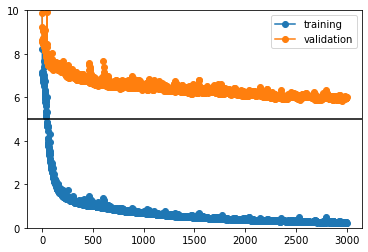

In [50]:
print("With predefined valid_ds?")
# plot net_regr's loss trace
train_loss = net_regr.history[:, 'train_loss']
valid_loss = net_regr.history[:, 'valid_loss']

plt.plot(train_loss, 'o-', label='training')
plt.plot(valid_loss, 'o-', label='validation')
plt.ylim(0,10)
plt.axhline(5,c='k')
plt.legend()
plt.show()

With train shuffle on?


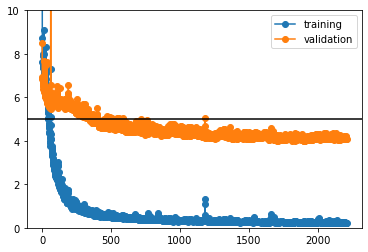

In [74]:
print("With train shuffle on?")
# plot net_regr's loss trace
train_loss = net_regr.history[:, 'train_loss']
valid_loss = net_regr.history[:, 'valid_loss']

plt.plot(train_loss, 'o-', label='training')
plt.plot(valid_loss, 'o-', label='validation')
plt.ylim(0,10)
plt.axhline(5,c='k')
plt.legend()
plt.show()

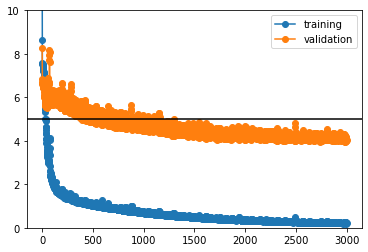

In [46]:
# plot net_regr's loss trace
train_loss = net_regr.history[:, 'train_loss']
valid_loss = net_regr.history[:, 'valid_loss']

plt.plot(train_loss, 'o-', label='training')
plt.plot(valid_loss, 'o-', label='validation')
plt.ylim(0,10)
plt.axhline(5,c='k')
plt.legend()
plt.show()

In [69]:
net_regr.train_split.check_cv(20)

KFold(n_splits=5, random_state=None, shuffle=False)

In [51]:
#chpt = torch.load("redo_best_st/best_chkpt.pkl")
chpt = pickle.load(open("redo_best_st/best_chkpt.pkl",'rb'))

In [52]:
chpt.optimizer

torch.optim.adam.Adam

In [90]:
# ytrain_pred = chpt.predict(Xtrain_full)
# ytest_pred = chpt.predict(Xtest)

ytrain_pred = net_regr.predict(Xtrain_full)
ytest_pred = net_regr.predict(Xtest)

In [91]:
p_train_full = scipy.stats.pearsonr(np.array(ytrain_full).flatten(),ytrain_pred.flatten())
p_test = scipy.stats.pearsonr(np.array(ytest).flatten(),ytest_pred.flatten())


No validation


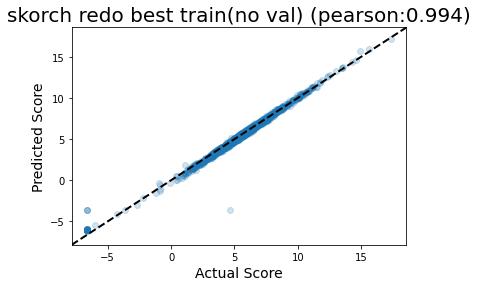

In [93]:
print("No validation")
parity_plot(
    "skorch redo best train(no val)", 
    ytrain_full, 
    ytrain_pred,
    p_train_full[0],
    rigid=True)


No validation


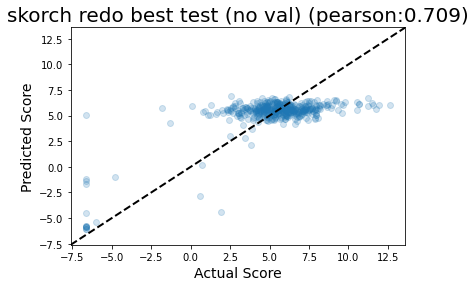

In [94]:
print("No validation")
parity_plot(
    "skorch redo best test (no val)", 
    ytest, 
    ytest_pred,
    p_test[0],
    rigid=True)


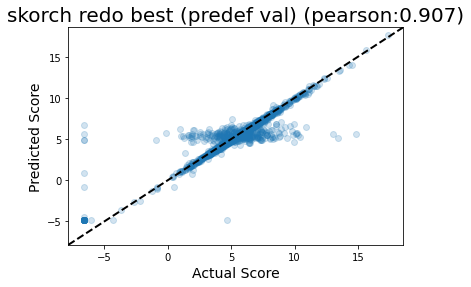

In [55]:
parity_plot(
    "skorch redo best (predef val)", 
    ytrain_full, 
    ytrain_pred,
    p_train_full[0],
    rigid=True)


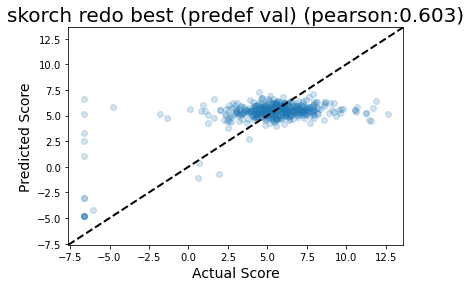

In [56]:
parity_plot(
    "skorch redo best (predef val)", 
    ytest, 
    ytest_pred,
    p_test[0],
    rigid=True)


In [57]:
train_full_df['act_vals'] = ytrain_full.flatten()
train_full_df['pred_vals'] = ytrain_pred.flatten()

train_full_df

,level_0,index,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,...,lowCu,highO2_slow_growth,NO3_lowO2_slow_growth,WithLanthanum,NoLanthanum,gene,product,group,act_vals,pred_vals
0,1,1,1,EQU24_RS00010,GTGGACGCGATCACACCACGGTTATTAATGCTTGTAAACGCATTGC...,5.906680,5.431592,5.067489,4.241518,5.897951,...,5.935676,6.629400,5.448133,5.385163,5.449226,,DNA polymerase III subunit beta,other,5.897951,5.810535
1,2,2,2,EQU24_RS00015,TTGCGAAGAGGGGCGGTTTCTCGTCCGACAGGCGTCGGCGGCAAGG...,5.085045,4.772192,4.208764,4.205855,4.821135,...,4.849435,5.487238,4.416274,4.367689,4.534353,recF,DNA replication/repair protein RecF,other,4.821135,4.532070
2,4,4,11,EQU24_RS00060,GAATTTTCGGGTTCGGGCATCAGCTACCGGGTATCGCCGGTACTCG...,4.766245,4.767261,3.688497,3.422344,4.763636,...,4.698693,4.286940,4.525268,5.031830,5.103249,,bifunctional diguanylate cyclase/phosphodieste...,other,4.763636,4.565582
3,6,6,15,EQU24_RS00080,ACTTTTACGGGACCCAGACTGAACGCAACAGGATCGATATTAGGAT...,3.677025,2.914081,2.798380,2.855937,3.402045,...,3.146899,3.717265,2.885832,3.709916,3.504557,,hypothetical protein,other,3.402045,3.198349
4,7,7,16,EQU24_RS00085,TTACCGGGCCGGATTTTTTGACATAGTTCGTTTAGGGTTGGCAATT...,6.119559,5.359881,5.232205,4.784122,5.642762,...,5.703369,6.023735,5.375778,5.544276,5.753625,,prolipoprotein diacylglyceryl transferase,other,5.642762,5.520663
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
348,2187,2187,4172,EQU24_RS21950,GTTGCCGCCAACAGCAGCGTCAAACGCTCGACATCTTGCTGCGTGT...,4.975076,4.419293,5.124366,4.809172,5.236178,...,5.139320,6.622547,4.828331,6.856076,6.244072,,sigma-70 family RNA polymerase sigma factor,other,5.236177,6.400372
349,2195,2195,4190,EQU24_RS22045,CCATGGATGGCGTGTATTAGGGCATCACCAGTAGGCGCTTTAGGCG...,6.461758,6.715490,5.850181,5.851119,6.404126,...,6.349203,6.950344,6.978197,8.497115,8.279553,,cyclic nucleotide-binding domain-containing pr...,other,6.404126,4.826966
350,2199,2199,4203,EQU24_RS22110,GAAGACTGCTCGGTTTGCTGTTCTCCTATTTACGTACAAATCGAAG...,13.068657,13.226416,12.868309,10.342361,13.026832,...,12.805209,11.760130,12.665751,11.945063,12.312213,,hypothetical protein,other,13.026832,5.674005
351,2200,2200,4204,EQU24_RS22115,AGCGCACCGCTATCGCTCTGGCTTAGATATCAAATCATTCGGCTAA...,5.444645,4.752288,4.198252,3.965749,5.428448,...,5.439160,5.341587,4.715536,3.997491,4.037671,,type II toxin-antitoxin system HicA family toxin,other,5.428448,4.822943


In [58]:
test_df['act_vals'] = ytest.flatten()
test_df['pred_vals'] = ytest_pred.flatten()

test_df

,index,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,medCu,...,lowCu,highO2_slow_growth,NO3_lowO2_slow_growth,WithLanthanum,NoLanthanum,gene,product,group,act_vals,pred_vals
0,0,0,EQU24_RS00005,ACTGTTAGCTTGGCACGGCCCTTGGCTCTGCGGGCGTTAAGGACTT...,5.701712,5.159314,4.946232,4.544309,5.470820,5.489315,...,5.425377,6.017577,5.002269,5.148210,5.063677,dnaA,chromosomal replication initiator protein DnaA,other,5.470819,5.625129
1,3,4,EQU24_RS00025,GATGGGCGACATCGTCGAACCGCGCCGGGATTTCATCGTCAAGAAT...,5.604311,5.064503,4.983838,4.084119,5.639215,5.606737,...,5.671486,6.282482,5.381454,5.098383,5.404872,,hypothetical protein,other,5.639215,5.494174
2,8,20,EQU24_RS00105,GACGAGCAACCGCCTAATCCGAGCAAAATCATTTCCATCGGCCGCG...,7.516533,6.885660,6.968519,5.639060,7.524764,7.295302,...,7.281908,7.112416,6.503747,6.019528,6.405467,crp,cAMP-activated global transcriptional regulato...,other,7.524764,5.141408
3,16,38,EQU24_RS00200,GATAGTGGTGTGCCTTCATTAATGACTGAAAACGTTCCCGCTCTTC...,4.469263,3.826175,3.604629,4.065608,4.307985,4.399904,...,4.356747,4.775299,3.618609,4.636796,4.542445,,hypothetical protein,other,4.307985,5.631394
4,29,57,EQU24_RS00295,CTGAGGATTTCCGGAATTATGCTATGCGGCAAGGCCAACTGACTGA...,3.468147,3.399429,2.798183,3.266460,2.671169,2.943016,...,2.900031,3.199630,2.557361,4.314085,4.773239,,hypothetical protein,other,2.671169,4.391927
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
436,2185,4170,EQU24_RS21940,AGGACTATTGCCTGTTATTGTTGATTCGATGCTCAGATTCTTTTTT...,6.412505,5.804235,4.783119,4.609521,5.279597,5.425026,...,5.177307,5.459230,4.829912,4.624704,4.742772,mgtE,magnesium transporter,other,5.279597,6.214789
437,2189,4181,EQU24_RS21995,TGACAAATAAACATGCAATCTATTTTCGACGATGAAAAAAAGCCTA...,5.454557,5.193189,4.795575,4.828034,4.839102,4.807549,...,4.684477,5.269057,4.820494,5.078786,5.342503,,ABC transporter ATP-binding protein,other,4.839102,5.176106
438,2191,4183,EQU24_RS22010,AAACTATGTAACTGTTTTCGCAAAGCTTCCGTTCCTGCTCACGCCC...,4.469140,4.146557,3.760300,4.006591,3.975661,3.873788,...,3.914836,4.556671,3.739244,4.228450,4.389134,,ABC transporter substrate-binding protein,other,3.975661,5.476089
439,2194,4189,EQU24_RS22040,ATTCAACTATACCGACTAACAGGTATTTAAAGTATACCCATCGCAC...,7.499348,6.874400,6.304143,5.984040,7.105188,7.103802,...,7.027282,7.446357,6.895007,7.038685,7.222180,,thioredoxin family protein,other,7.105188,5.845350


In [62]:
thresh = 1200000#1500000#500000
train_full_df['early'] = train_full_df['coord'].apply(lambda x: x < thresh)
test_df['early'] = test_df['coord'].apply(lambda x: x < thresh)

alt.Chart(train_full_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color=alt.Color('early:N'),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [84]:
alt.Chart(test_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color=alt.Color('early:N'),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [64]:
train_df

,level_0,index,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,medCu,highCu,lowCu,highO2_slow_growth,NO3_lowO2_slow_growth,WithLanthanum,NoLanthanum,gene,product
0,1,1,1,EQU24_RS00010,GTGGACGCGATCACACCACGGTTATTAATGCTTGTAAACGCATTGC...,5.906680,5.431592,5.067489,4.241518,5.897951,6.022614,6.305779,5.935676,6.629400,5.448133,5.385163,5.449226,,DNA polymerase III subunit beta
1,2,2,2,EQU24_RS00015,TTGCGAAGAGGGGCGGTTTCTCGTCCGACAGGCGTCGGCGGCAAGG...,5.085045,4.772192,4.208764,4.205855,4.821135,4.878684,5.067555,4.849435,5.487238,4.416274,4.367689,4.534353,recF,DNA replication/repair protein RecF
2,4,4,11,EQU24_RS00060,GAATTTTCGGGTTCGGGCATCAGCTACCGGGTATCGCCGGTACTCG...,4.766245,4.767261,3.688497,3.422344,4.763636,4.687598,4.858654,4.698693,4.286940,4.525268,5.031830,5.103249,,bifunctional diguanylate cyclase/phosphodieste...
3,6,6,15,EQU24_RS00080,ACTTTTACGGGACCCAGACTGAACGCAACAGGATCGATATTAGGAT...,3.677025,2.914081,2.798380,2.855937,3.402045,3.168685,3.189847,3.146899,3.717265,2.885832,3.709916,3.504557,,hypothetical protein
4,7,7,16,EQU24_RS00085,TTACCGGGCCGGATTTTTTGACATAGTTCGTTTAGGGTTGGCAATT...,6.119559,5.359881,5.232205,4.784122,5.642762,6.053625,6.152638,5.703369,6.023735,5.375778,5.544276,5.753625,,prolipoprotein diacylglyceryl transferase
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1405,2193,2193,4187,EQU24_RS22030,CGAACAGGCTTGGGCATGGGTCGATTCGATACAAGATGCTTGGGCG...,6.663969,6.174425,5.409798,5.321395,5.974878,6.180796,6.004435,6.048469,6.282470,5.660553,5.545775,5.772267,pcp,pyroglutamyl-peptidase I
1406,2197,2197,4198,EQU24_RS22085,AATCGACCCGGTCAATTTATACACAGTAATACACAAGAAACTCACC...,6.227108,5.627004,5.073001,4.744599,5.632152,6.004911,5.970586,5.735786,5.623184,5.041027,6.255540,6.089869,,MoxR family ATPase
1407,2198,2198,4199,EQU24_RS22090,ACAACTTTTATGCCGAAAGGTTCCCATTGTATCTGTATGAGGACCG...,4.525321,4.229571,3.885579,4.106419,4.372610,4.282010,4.297492,4.237955,4.786416,4.073122,4.205149,4.251908,,POT family MFS transporter
1408,2201,2201,4206,EQU24_RS22125,ACTGGTACGACAGCGAAACAATTTTAAAGAAATAGCACGACACGTT...,5.525397,4.994987,4.338536,4.700682,5.473124,5.129023,5.526986,5.204482,5.214882,4.556138,5.621077,5.479719,,DUF4102 domain-containing protein


In [65]:
val_loci = set(val_df['locus_tag'].values)
train_full_df['set'] = train_full_df['locus_tag'].apply(lambda x: "val" if x in val_loci else "train")

In [74]:
test_df['set'] = 'test'
full_df = pd.concat([train_full_df,test_df])

In [68]:
train_full_df.tail(20)

,level_0,index,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,...,WithLanthanum,NoLanthanum,gene,product,group,act_vals,pred_vals,coord,early,set
333,2047,2047,3940,EQU24_RS20730,TGATAATGGTAACGTCAGCATCTTGTACTACCTCATCCAATATAGA...,6.054139,5.516037,5.435466,5.155704,6.286772,...,5.607106,5.673530,,type II toxin-antitoxin system Phd/YefM family...,other,6.286772,5.876432,4670508,False,val
334,2052,2052,3949,EQU24_RS20775,GGCAATAATTAATAGCAGTATTAACAAGAAAACGGTCATTCCGATC...,4.318810,3.874797,3.475799,3.590161,3.856529,...,4.789638,4.886103,,"UDP-2,3-diacylglucosamine diphosphatase",other,3.856529,4.766215,4678438,False,val
335,2057,2057,3954,EQU24_RS20800,CATCACCGATAAAGGCGGTACTTATCAAGTTTCCGGGAACCTACCC...,4.168668,4.244402,4.133578,3.959125,4.025326,...,6.067616,6.185843,,hypothetical protein,other,4.025326,5.087738,4685949,False,val
336,2060,2060,3959,EQU24_RS20825,AAATATTTTATACAGAGCCCAAAAAGGCTATAGTAATCCTCAAAAG...,4.675735,4.286549,3.839425,3.665738,4.383287,...,4.497266,4.696592,recC,exodeoxyribonuclease V subunit gamma,other,4.383287,5.359018,4688306,False,val
337,2062,2062,3961,EQU24_RS20835,TTTTTTAGAGCTCGACCAACATTATCACTGCGATTTAACGCAACAG...,7.423832,6.882728,7.424896,5.524709,7.720002,...,8.269795,8.220831,,accessory factor UbiK family protein,other,7.720002,5.882946,4692354,False,val
338,2076,2076,3985,EQU24_RS20960,GTTTTCGGCTTTTATGGCAATGCTATTTTGTTCGGTAGCAAGGCGC...,4.875248,4.721049,4.393784,4.296246,4.755760,...,5.406446,5.275387,,sensor domain-containing diguanylate cyclase,other,4.755761,5.648164,4719041,False,val
339,2087,2087,3998,EQU24_RS21030,CGTAGACAATATAAGACTAAAAATGTTTAAAACAAGTCAGAATACT...,6.422886,5.796836,5.434534,5.472999,5.780233,...,5.961961,5.964843,,cyclic nucleotide-binding domain-containing pr...,other,5.780233,5.553376,4739251,False,val
340,2093,2093,4013,EQU24_RS21105,CGCAGCAAGCCCGGGGAAGGCACGGCTATATCGGTTGTTTTTCCGA...,4.756338,4.343859,3.965775,4.033022,4.543494,...,4.932564,4.895520,pyp,photoactive yellow protein,other,4.543494,6.092428,4753191,False,val
341,2094,2094,4020,EQU24_RS21140,AAAATGCCTGATTTTAGGATGTTTTCCGGCGTTCTGTTCGGCCGGA...,4.776425,3.766157,3.764439,3.299142,4.646196,...,5.679639,5.466357,,acyl-CoA desaturase,other,4.646196,5.277803,4761964,False,val
342,2099,2099,4026,EQU24_RS21170,ATGTTCGGAGCGGGTTGAATAACCTGCCACGCGTGAGGTTATTATG...,5.726108,5.385711,5.049884,4.250161,5.281267,...,5.637368,5.822724,,hypothetical protein,other,5.281267,5.308463,4768227,False,val


In [69]:
# thresh = 1200000#1500000#500000
# train_full_df['early'] = train_full_df['coord'].apply(lambda x: x < thresh)
# test_df['early'] = test_df['coord'].apply(lambda x: x < thresh)

alt.Chart(train_full_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color=alt.Color('set:N'),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [75]:
alt.Chart(full_df).mark_point(size=100).encode(
    x='act_vals:Q',
    y='pred_vals:Q',
    color=alt.Color('set:N'),
    tooltip=['locus_tag:N','gene:N','product:N','group:N','coord:Q']
).configure_axis(
    labelFontSize=14,
    titleFontSize=20
).interactive()

alt.Chart(...)

In [71]:
train_full_df.sort_values("coord").head(20)

,level_0,index,og_index,locus_tag,upstream_region,uMax,lowO2_fast_growth,lowCH4,MeOH,NoCu,...,WithLanthanum,NoLanthanum,gene,product,group,act_vals,pred_vals,coord,early,set
0,1,1,1,EQU24_RS00010,GTGGACGCGATCACACCACGGTTATTAATGCTTGTAAACGCATTGC...,5.906680,5.431592,5.067489,4.241518,5.897951,...,5.385163,5.449226,,DNA polymerase III subunit beta,other,5.897951,5.810535,1502,True,train
1,2,2,2,EQU24_RS00015,TTGCGAAGAGGGGCGGTTTCTCGTCCGACAGGCGTCGGCGGCAAGG...,5.085045,4.772192,4.208764,4.205855,4.821135,...,4.367689,4.534353,recF,DNA replication/repair protein RecF,other,4.821135,4.532070,3060,True,train
2,4,4,11,EQU24_RS00060,GAATTTTCGGGTTCGGGCATCAGCTACCGGGTATCGCCGGTACTCG...,4.766245,4.767261,3.688497,3.422344,4.763636,...,5.031830,5.103249,,bifunctional diguanylate cyclase/phosphodieste...,other,4.763636,4.565582,13842,True,train
0,5,5,12,EQU24_RS00065,GCAAGACGATCCGAACGGTCACGGTCTTTTGTGCGTGAACCATGAG...,3.568006,3.539326,2.584676,2.775291,3.034904,...,3.469896,3.526913,,DUF839 domain-containing protein,other,3.034904,5.032066,17565,True,val
3,6,6,15,EQU24_RS00080,ACTTTTACGGGACCCAGACTGAACGCAACAGGATCGATATTAGGAT...,3.677025,2.914081,2.798380,2.855937,3.402045,...,3.709916,3.504557,,hypothetical protein,other,3.402045,3.198349,20389,True,train
4,7,7,16,EQU24_RS00085,TTACCGGGCCGGATTTTTTGACATAGTTCGTTTAGGGTTGGCAATT...,6.119559,5.359881,5.232205,4.784122,5.642762,...,5.544276,5.753625,,prolipoprotein diacylglyceryl transferase,other,5.642762,5.520663,21633,True,train
5,9,9,21,EQU24_RS00110,CCGATACTGACAGAGCCTTCGATAATAAAATAGAGACGGTCACCGG...,8.380284,7.813549,7.205850,6.246327,8.328173,...,6.282590,6.475059,,OsmC family protein,other,8.328173,9.080130,25137,True,train
6,10,10,23,EQU24_RS00125,CGTAGCGATAGCAGCCCGTTACGGTATCGAGCAAGTTCCGCAATAC...,5.897769,5.731658,6.100741,5.054938,6.403770,...,6.787350,6.824418,,autotransporter outer membrane beta-barrel dom...,other,6.403770,6.339502,29783,True,train
7,11,11,31,EQU24_RS00165,GCGGCCCCGATTCGCCCTGCGTCCGTGCCACTACGCCACATCATCG...,2.552448,2.011989,2.229248,2.131699,2.686552,...,3.781009,3.645024,,hypothetical protein,other,2.686553,2.634379,36832,True,train
1,12,12,33,EQU24_RS00175,ATTGGGTAAGCAGGCTTCACTATAAGTTTTGGGGTAATGTTTTAGG...,0.024290,-0.236382,-0.824218,-0.954470,1.226870,...,0.913039,1.144301,,hypothetical protein,other,1.226870,5.361468,39992,True,val


In [111]:
def get_conv_layers_from_model(model):
    '''
    Given a trained model, extract its convolutional layers
    '''
    model_children = list(model.children())
    
    # counter to keep count of the conv layers
    model_weights = [] # we will save the conv layer weights in this list
    conv_layers = [] # we will save the actual conv layers in this list
    bias_weights = []
    counter = 0 

    # append all the conv layers and their respective weights to the list
    for i in range(len(model_children)):
        # get model type of Conv1d
        if type(model_children[i]) == nn.Conv2d:
            counter += 1
            model_weights.append(model_children[i].weight)
            conv_layers.append(model_children[i])
            bias_weights.append(model_children[i].bias)

        # also check sequential objects' children for conv1d
        elif type(model_children[i]) == nn.Sequential:
            for child in model_children[i]:
                if type(child) == nn.Conv2d:
                    counter += 1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
                    bias_weights.append(child.bias)

    print(f"Total convolutional layers: {counter}")
    return conv_layers, model_weights, bias_weights

def view_filters(model_weights, num_cols=8):
    # squeeze for conv2d??
    model_weights = model_weights[0].squeeze(1)
    num_filt = model_weights.shape[0]
    filt_width = model_weights[0].shape[1]
    num_rows = int(np.ceil(num_filt/num_cols))
    
    # visualize the first conv layer filters
    plt.figure(figsize=(20, 17))

    for i, filter in enumerate(model_weights):
        ax = plt.subplot(num_rows, num_cols, i+1)
        ax.imshow(filter.detach(), cmap='gray')
        ax.set_yticks(np.arange(4))
        ax.set_yticklabels(['A', 'C', 'G','T'])
        ax.set_xticks(np.arange(filt_width))
        ax.set_title(f"Filter {i}")

    plt.tight_layout()
    plt.show()
    
def get_conv_output_for_seq(seq, conv_layer):
    '''
    Given an input sequeunce, get the output tensor containing the filter activations
    '''
    #print(f"Running seq {seq}")
    # format seq for input to conv layer (OHE, reshape)
    seq = torch.tensor(u.one_hot_encode(seq)).view(-1,len(seq),4).permute(0,2,1).unsqueeze(0)
    # OHE FIX??
    # run through conv layer
    with torch.no_grad(): # don't want as part of gradient graph?
        res = conv_layer(seq.float())
        return res[0]
    

def get_filter_activations(seqs, conv_layer):
    '''
    Given a set of input sequences and a trained convolutional layer, 
    determine the subsequences for which each filter in the conv layer 
    activate most strongly. 
    
    1.) Run inputs through conv layer. 
    2.) Loop through filter activations of the resulting tensor, saving the
            position where filter activations were >0. 
    3.) Compile a count matrix for each filter by accumulating subsequences which
            activate the filter
    '''
    # initialize dict of pwms for each filter in the conv layer
    num_filters = conv_layer.out_channels
    filt_width = conv_layer.kernel_size[1]
    filter_pwms = dict((i,torch.zeros(4,filt_width)) for i in range(num_filters))
    
    print("Num filters", num_filters)
    print("filt_width", filt_width)
    #print("filter_pwms", filter_pwms)
    
    # loop through a set of sequences and collect subseqs where each filter activated
    for seq in seqs:
        res = get_conv_output_for_seq(seq, conv_layer)
        # for each filter and it's activation vector
        for filt_id,act_vec in enumerate(res):
            act_idxs = torch.where(act_vec>0)[1]
            activated_positions = [x.item() for x in act_idxs]
            # get subsequences that caused filter to activate
            for pos in activated_positions:
                subseq = seq[pos:pos+filt_width]
                #print("subseq",pos, subseq)
                #subseq_tensor = torch.tensor(u.one_hot_encode(subseq)).view(-1,filt_width,4).permute(0,2,1).squeeze(0)
                #subseq_tensor = torch.tensor(u.one_hot_encode(subseq)).permute(0,2,1).squeeze(0)
                # OHE FIX??
                subseq_tensor = torch.tensor(u.one_hot_encode(subseq)).T
                # add this subseq to the pwm count for this filter
                filter_pwms[filt_id] += subseq_tensor            
            
    return filter_pwms

import logomaker
def view_filters_and_logos(model_weights,filter_activations, num_cols=8):
    #print(model_weights[0].shape)
    model_weights = model_weights[0].squeeze(1)
    print(model_weights.shape)
    seq_len = model_weights.shape[-1]
    
    assert(model_weights.shape[0] == len(filter_activations))
    # make sure the model weights agree with the number of filters
    num_filts = len(filter_activations)
    num_rows = int(np.ceil(num_filts/num_cols))*2+1 # not sure why +1 is needed... complained otherwise
    
    plt.figure(figsize=(20, 17))

    j=0 # use to make sure a filter and it's logo end up vertically paired
    for i, filter in enumerate(model_weights):
        if (i)%num_cols == 0:
            j += num_cols
    #     print('i:', i)
    #     print('j:', j)
    #     print('i%8 == 0', i%8 == 0)
    # #     print('i+1%9 =?', (i+1)%9)
    #     print("i+j+1=", i+j+1)
    #     print("i+j+1+4=", i+j+1+8)
    #     print("*******")

        # display raw filter
        ax1 = plt.subplot(num_rows, num_cols, i+j+1)
        ax1.imshow(filter.detach(), cmap='gray')
        ax1.set_yticks(np.arange(4))
        ax1.set_yticklabels(['A', 'C', 'G','T'])
        ax1.set_xticks(np.arange(seq_len))
        ax1.set_title(f"Filter {i}")

        # display sequence logo
        ax2 = plt.subplot(num_rows, num_cols, i+j+1+num_cols)
        filt_df = pd.DataFrame(filter_activations[i].T.numpy(),columns=['A','C','G','T'])
        filt_df_info = logomaker.transform_matrix(filt_df,from_type='counts',to_type='information')
        logo = logomaker.Logo(filt_df_info,ax=ax2)
        ax2.set_ylim(0,2)
        ax2.set_title(f"Filter {i}")

    plt.tight_layout()

In [116]:
train_seqs = train_df['upstream_region'].values

def view_conv_filters_for_cnn(cnn,seqs):
    conv_layers, model_weights, bias_weights = get_conv_layers_from_model(cnn)
    #view_filters(model_weights)
    filter_activations = get_filter_activations(seqs, conv_layers[0])
    view_filters_and_logos(model_weights,filter_activations)

Total convolutional layers: 2
Num filters 32
filt_width 16
torch.Size([32, 4, 16])


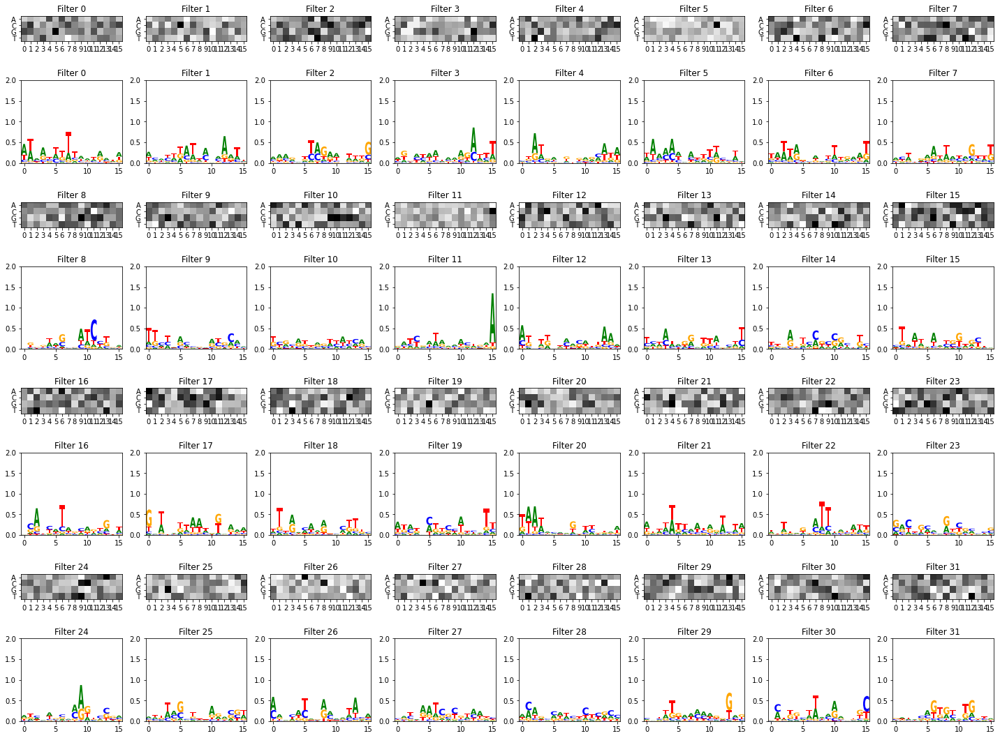

In [119]:
view_conv_filters_for_cnn(best.module_,train_seqs)

In [118]:
import torch
from torch.utils.data import TensorDataset,DataLoader,Dataset
from torch import nn